In [2]:
from mpl_toolkits.mplot3d.axes3d import get_test_data
from mpl_toolkits.mplot3d import axes3d
import matplotlib.pyplot as plt
from matplotlib import cm
import random
import numpy


In [ ]:
# Определеяем функцию
def f(x,y):
  return (x**2/800 - y**2/800 + 1/2)

<Figure size 1920x960 with 0 Axes>

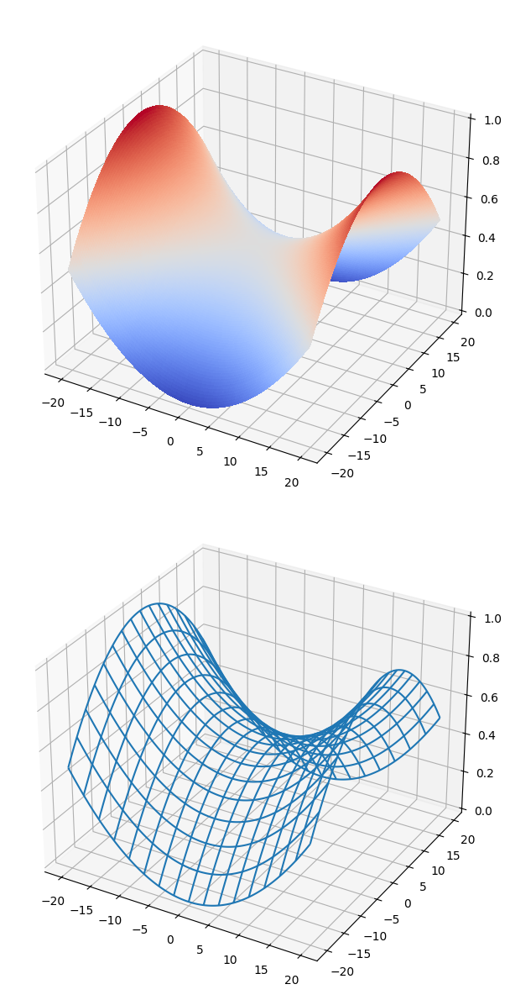

In [ ]:
# Визуализируем функцию
fig = plt.figure(figsize=plt.figaspect(0.5), dpi=200)

fig, (ax1, ax2) = plt.subplots(
    2, 1, figsize=(8, 12), subplot_kw={'projection': '3d'})

X = numpy.arange(-20, 20, 0.25)
Y = numpy.arange(-20, 20, 0.25)
X, Y = numpy.meshgrid(X, Y)
Z = f(X,Y)
ax1.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap=cm.coolwarm, linewidth=0, antialiased=False)
ax2.plot_wireframe(X, Y, Z, rstride=10, cstride=10)

plt.tight_layout()
plt.show()

In [5]:
class GeneticAlgorithm:
    # Конструктор для иницализации генетического алгоритма. population_size - количество особей в начальной популяции; x_range, y_range - диапазон осей; p - вероятность мутации
    def __init__(self, function, population_size=20, x_range=(-20, 20), y_range=(-20, 20), p=0.1, parent_selection_method = 'panmixia'):
        self.function = function
        self.population_size = population_size # кол-во особей
        self.x_range = x_range # диапазон х
        self.y_range = y_range # диапазон у
        self.p = p # вероятность мутации
        self.parent_selection_method = parent_selection_method # способ выбора родителей
        self.population = self.initialize_population() # инициализация начальной популяции

    # Инициализация начальной популяции
    def initialize_population(self):
        population = [] # список особей популяции
        while len(population) < self.population_size:
            # генерация случайных точек х и у пока не сгенерируем количество_точек = размер_популяции
            x = random.uniform(self.x_range[0], self.x_range[1])
            y = random.uniform(self.y_range[0], self.y_range[1])
            z = self.function(x, y) # Вычисление значения функции f(x, y)
            # Проверка особи на уникальность
            if [x, y, z] not in population:
                population.append([x, y, z])
        print(population) # просмотр популяции
        return numpy.array(population)

    # функция добавления случайного отклонения
    def rn(self, mu, sigma):
        r_n = random.normalvariate(mu, sigma) # генерация случайного числа с нормальным распределением
        r = min(r_n, self.x_range[1]) if r_n > 0 else max(r_n, self.x_range[0]) # ограничение значения диапазоном
        # Случайный выбор между нормальным и равномерным распределением
        return r if random.random() > 0.5 else random.uniform(self.x_range[0], self.x_range[1])

    # Мутация ососби
    def mutate(self, individual):
       # Проверка на вероятность мутации для x
        if random.random() < self.p:
            individual[0] = self.rn(individual[0], sigma=1) # мутация х
        # Проверка на вероятность мутации для у
        if random.random() < self.p:
            individual[1] = self.rn(individual[1], sigma=1)  # мутация у
        individual[2] = self.function(individual[0], individual[1]) # Обновление значения функции после мутации
        return individual

    #  Турнирная селекция
    def tournament_selection(self, tournament_size=2):
        selected = []
        for _ in range(self.population_size):
            # выбор участников турнира
            contestants = random.choices(self.population, k=tournament_size)
            # выбор победителя (с минимальным значением z)
            winner = min(contestants, key=lambda x: x[2])
            selected.append(winner)
        return numpy.array(selected)

    # Метод рулетки
    def roulette_method(self):
        # Вычисление приспособленности (обратно пропорционально значению z)
        fitness_values = 1 / (self.population[:, 2] + 1e-6)  # Добавляем небольшое значение, чтобы избежать деления на ноль
        total_fitness = numpy.sum(fitness_values) # сумма всех приспособленностей
        probs = fitness_values / total_fitness # вероятность выбора особи
        selected_indices = numpy.random.choice(len(self.population), size=self.population_size, p = probs) # выбор особи (зависит от значения функции приспособленности)
        return self.population[selected_indices]

    # Метод ранжирования
    def ranking_method(self):
        sorted_population = self.population[self.population[:, 2].argsort()]  # Сортировка по возрастанию z
        ranks = numpy.arange(len(sorted_population), 0, -1)  # лучшие особи получают большие ранги (они вначале)
        probs = ranks / numpy.sum(ranks)  # вычиление вероятностей на основе рангов
        selected_indices = numpy.random.choice(len(sorted_population), size=self.population_size, p=probs) # выбор особей
        return sorted_population[selected_indices]

    # Метод равномерного ранжирования
    def uniform_ranking_method(self):
        sorted_population = self.population[self.population[:, 2].argsort()]  # Сортировка по возрастанию z
        probs = numpy.ones(len(sorted_population)) / len(sorted_population)  # Равные вероятности для каждой особи
        selected_indices = numpy.random.choice(len(sorted_population), size=self.population_size, p=probs) # выбор особей на совнове равных вероятностей
        return sorted_population[selected_indices]

    # Сигма-отсечение
    def sigma_clipping(self):
        # Чем меньше z, тем выше приспособленность
        fitness_values = 1 / (self.population[:, 2] + 1e-6)  # Добавляем 1e-6, чтобы избежать деления на ноль

        # Масштабирование с использованием сигма-отсечения
        mean_fitness = numpy.mean(fitness_values) # Среднее значение приспособленности
        std_fitness = numpy.std(fitness_values) # Стандартное отклонение приспособленности
        scaled_fitness = numpy.maximum(0, fitness_values - (mean_fitness - 2 * std_fitness))  # Отсечение: особи с приспособленностью ниже (mean - 2 * std) отбрасываются

        # Нормализация вероятностей
        total_fitness = numpy.sum(scaled_fitness)
        if total_fitness == 0:
            probs = numpy.ones(len(self.population)) / len(self.population)  # Равные вероятности, если все приспособленности нулевые
        else:
            probs = scaled_fitness / total_fitness # иначе вычисляем вероятности

        # Выбор особей на основе вероятностей
        selected_indices = numpy.random.choice(len(self.population), size=self.population_size, p=probs)
        return self.population[selected_indices]

    # Выбор родителей в зависимости от метода
    def select_parents(self):
        if self.parent_selection_method == 'panmixia':
            # Панмиксия: случайный выбор родителей
            parent1, parent2 = random.choices(self.population, k=2)
        elif self.parent_selection_method == 'inbreeding':
            # Инбридинг: выбор наиболее близких по значению z родителей
            sorted_population = self.population[self.population[:, 2].argsort()]
            parent1 = sorted_population[0]
            parent2 = sorted_population[1]
        elif self.parent_selection_method == 'outbreeding':
            # Аутбридинг: выбор наиболее далеких по значению z родителей
            sorted_population = self.population[self.population[:, 2].argsort()]
            parent1 = sorted_population[0]
            parent2 = sorted_population[-1]
        else:
            raise ValueError("Неизвестный метод выбора родителей")
        return parent1, parent2

    # Размножение двух родителей
    def crossover(self, parent1, parent2):
        # Создание двух детей: один наследует x от первого родителя, y от второго, и наоборот
        child1 = [parent1[0], parent2[1], self.function(parent1[0], parent2[1])]
        child2 = [parent2[0], parent1[1], self.function(parent2[0], parent1[1])]
        return child1, child2

    # Эволюция популяции. Здесь generations - количество поколений, а selection_method - метод селекции (турнирный по умолчанию)
    def evolve(self, generations=20, selection_method='tournament'):
        for _ in range(generations):
            # выбор метоад селекции
            if selection_method == 'tournament':
                selected = self.tournament_selection()
            elif selection_method == 'roulette':
                selected = self.roulette_method()
            elif selection_method == 'ranking':
                selected = self.ranking_method()
            elif selection_method == 'uniform_ranking':
                selected = self.uniform_ranking_method()
            elif selection_method == 'sigma':
                selected = self.sigma_clipping()
            else:
                raise ValueError("Неизвестный метод селекции")

            # Размножение
            new_population = []
            for i in range(0, len(selected), 2):
                parent1 = selected[i]
                parent2 = selected[i + 1] if i + 1 < len(selected) else selected[0]
                child1, child2 = self.crossover(parent1, parent2)
                new_population.append(child1)
                new_population.append(child2)

            # Мутация
            new_population = [self.mutate(individual) for individual in new_population]

            # Обновление популяции
            self.population = numpy.array(new_population)
            # Сортировка по значению функции (третий столбец)
            self.population = self.population[self.population[:, 2].argsort()]

            # Визуализация
            self.build_3d_graph()

    # Визуализация текущего состояния популяции
    def build_3d_graph(self):
        fig, ax = plt.subplots(subplot_kw={"projection": "3d"})

        # Создаем сетку для построения поверхности
        X = numpy.arange(self.x_range[0], self.x_range[1], 0.25)
        Y = numpy.arange(self.y_range[0], self.y_range[1], 0.25)
        X, Y = numpy.meshgrid(X, Y)
        Z = self.function(X, Y)

        # Отображаем поверхность функции
        ax.plot_surface(X, Y, Z, rstride=10, cstride=10, cmap=cm.coolwarm, alpha=0.5)

        # Отображаем точки из популяции
        ax.scatter(self.population[:, 0], self.population[:, 1], self.population[:, 2], color='black', s=50)

        # Настройка графика
        ax.set_xlabel('X')
        ax.set_ylabel('Y')
        ax.set_zlabel('Z')
        ax.set_title('Генетический алгоритм: оптимизация функции f(x, y)')
        #ax.view_init(elev=30, azim=180)  # elev - угол наклона, azim - азимутальный угол
        plt.tight_layout()
        plt.show()

*Метод ранжирования*

[[-8.515792302394072, 12.861445575551201, 0.3838774203058107], [-8.676067259997673, 7.966162211065466, 0.5147680034087452], [3.4488142944778453, 14.275996091131475, 0.26011281955474197], [7.567634554336188, 8.814093403801895, 0.4744760627712987], [5.693599089097312, -14.983457523583713, 0.25989133903291545], [-1.693239466350029, -18.611042498181767, 0.07062019627659688], [10.404873039168749, 8.657079257139529, 0.5416454521210315], [-0.01129215494328406, 15.523355610163755, 0.19878194764145096], [-4.371947249445212, 10.202375936126433, 0.3937818100123498], [11.793325952181423, -10.732311386378722, 0.5298750366502518], [-7.521453213672661, -11.99716759315329, 0.3908002852340742], [-18.399231000376904, -12.545320925225333, 0.7264332803604173], [-11.134342190589948, -1.16979271444675, 0.6532564512779733], [-6.484059386989628, 17.199784466330783, 0.18276305055721825], [18.088706539327546, 4.809086029502772, 0.8800924947834405], [6.737712291386842, -13.831744882166234, 0.3175995005452169], [

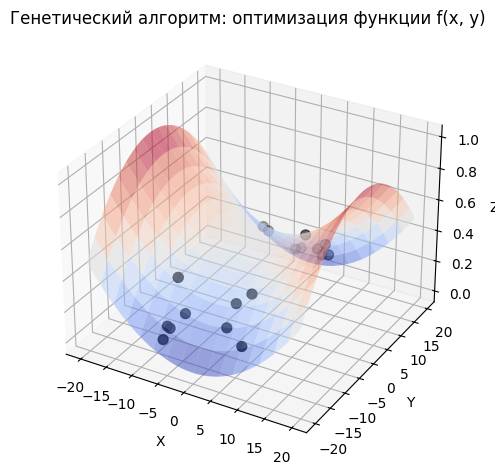

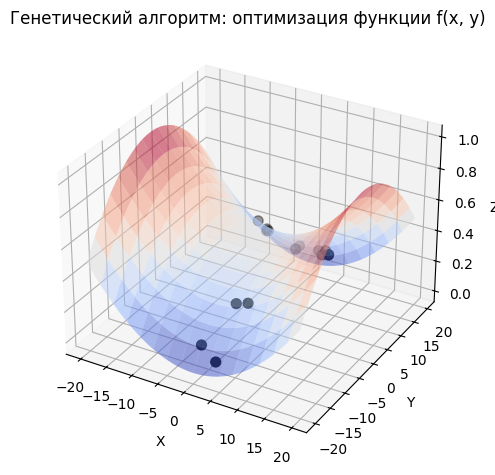

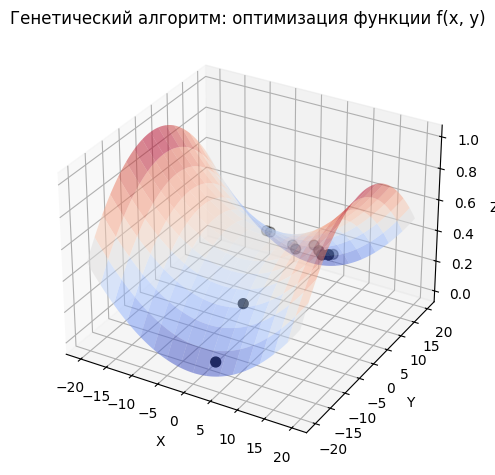

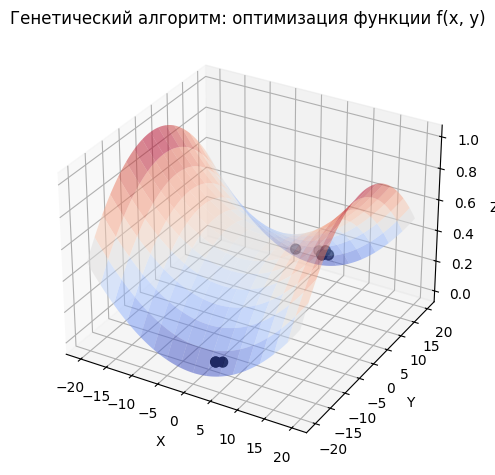

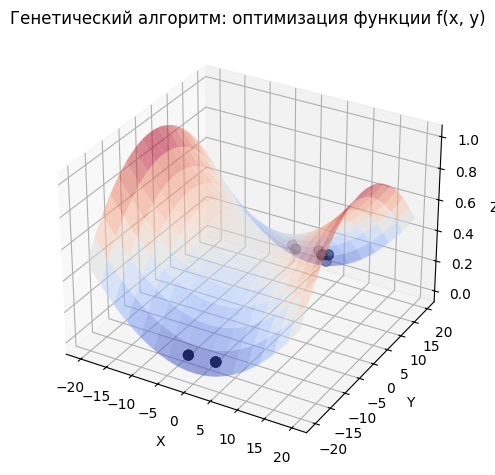

...

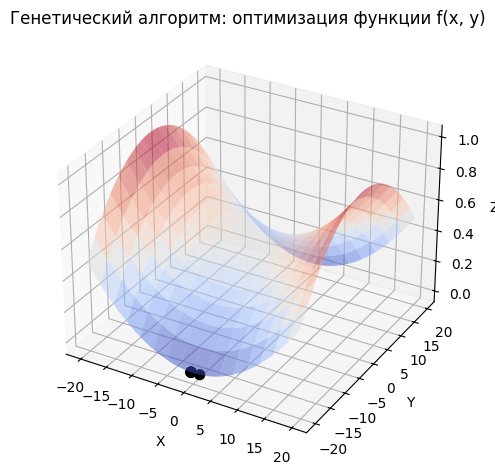

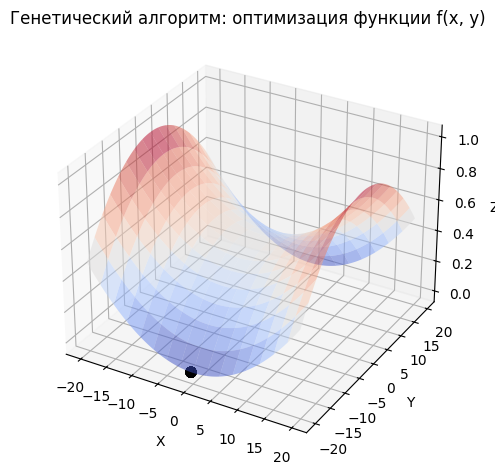

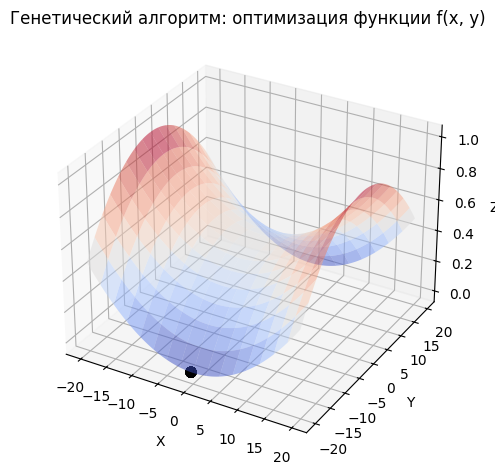

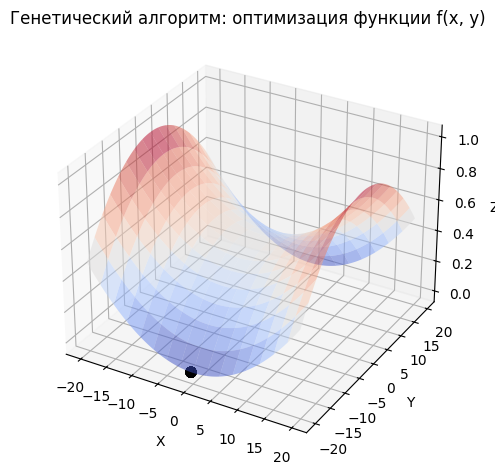

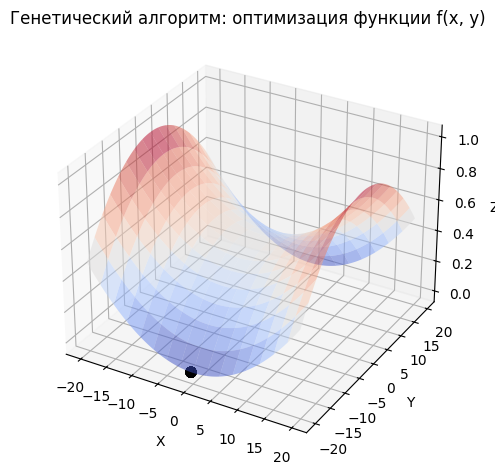

In [ ]:
# Создаем экземпляр класса и запускаем эволюцию
ga = GeneticAlgorithm(f, population_size=20, p = 0.01, parent_selection_method='inbreeding')
ga.evolve(generations=40, selection_method='ranking')

*Метод рулетки*

[[11.224798554150436, -14.267714600579794, 0.4030355283220749], [-9.976894678793219, 10.71405540897446, 0.480934305156447], [-15.919048955003067, -19.11796214897582, 0.35989955362764003], [1.7468333646044698, -7.825799777499265, 0.4272603558077348], [2.906622733110961, 13.919149871012003, 0.26838215322618], [6.774527352000245, 18.087138168463824, 0.1484370671473732], [14.87164404870142, 1.019071462467501, 0.7751591125820758], [8.044869635110356, -9.400615155689893, 0.47043545267566766], [-11.875585862191027, 17.78842350641831, 0.2807519109082198], [-4.491134826927077, 12.131140097053972, 0.3412571649741083], [-10.753186831770272, 14.653763531554297, 0.37612280175030866], [-7.809673150967145, 0.7681566379840277, 0.5755011626305727], [-19.38475641587367, 8.454723159215455, 0.8803580470047265], [2.559393433414158, -17.971249774398885, 0.10448084536646446], [-4.92991885833284, -6.824189629637946, 0.4721681698106096], [1.8799619145382565, -1.2722119544816977, 0.5023946669287352], [-14.83089

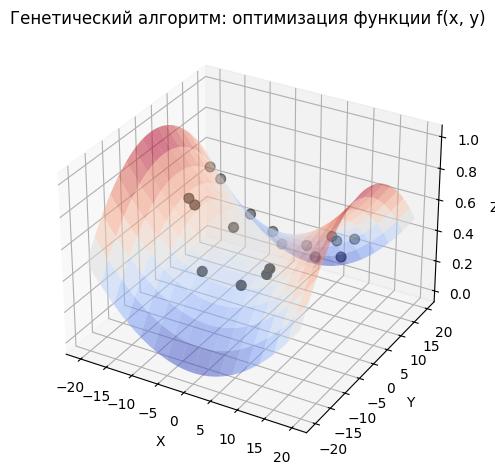

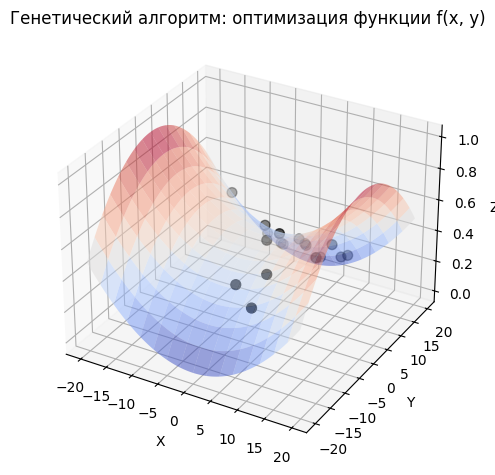

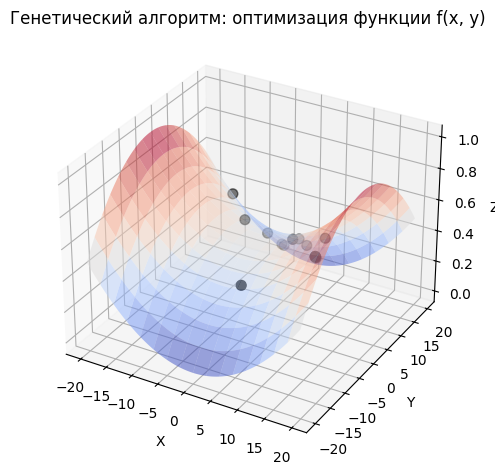

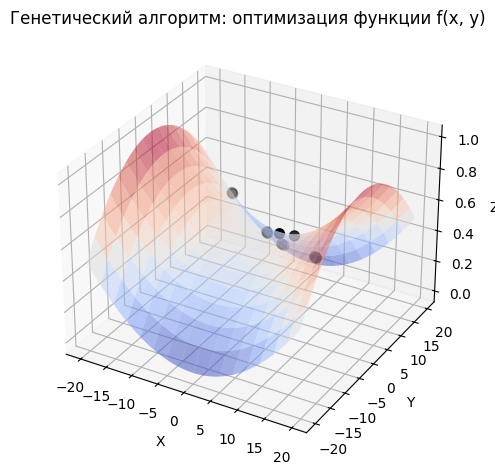

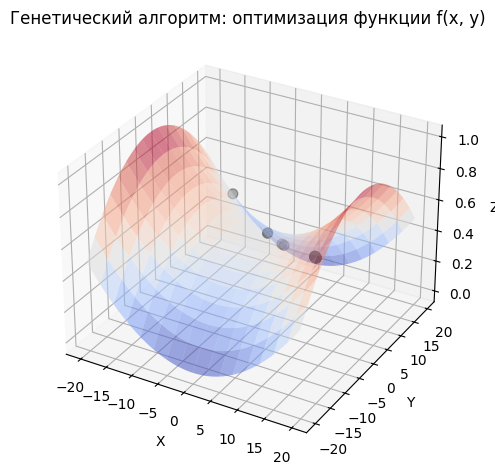

...

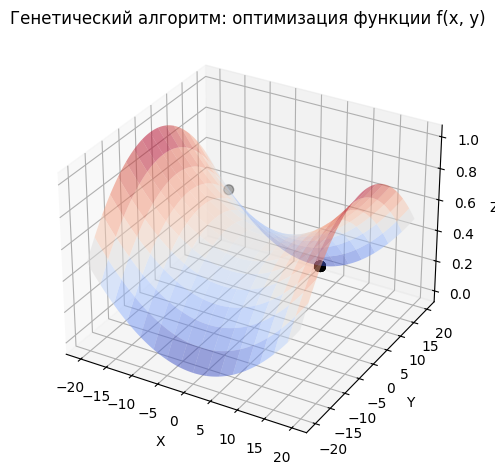

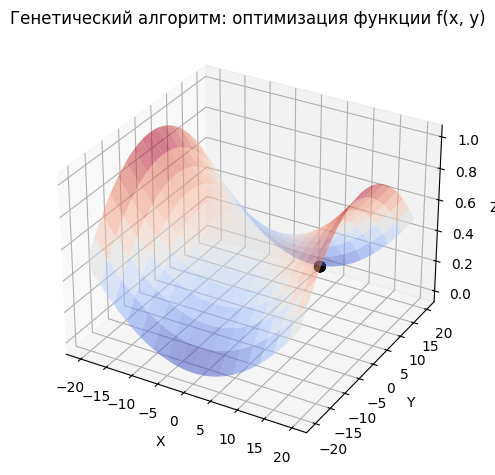

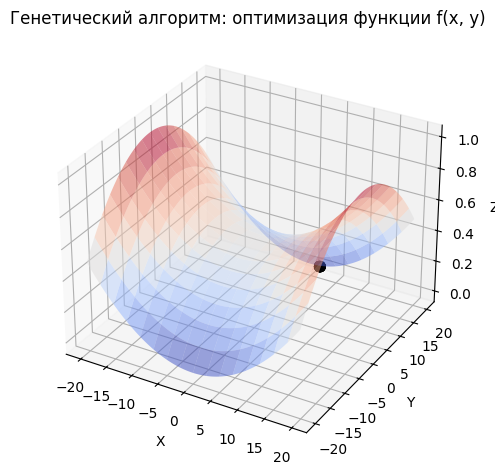

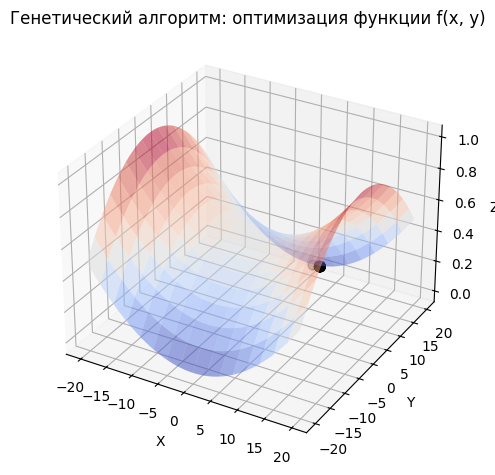

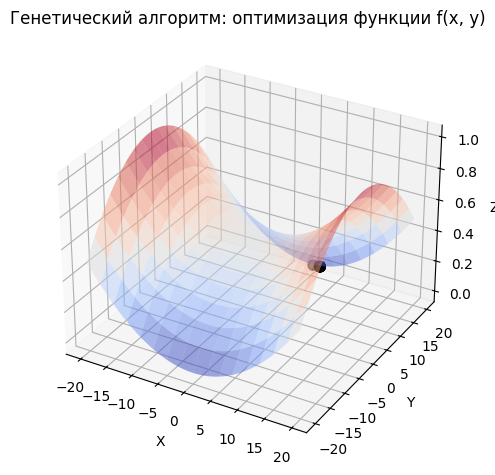

In [ ]:
# Создаем экземпляр класса и запускаем эволюцию
ga = GeneticAlgorithm(f, population_size=20, p = 0.01, parent_selection_method='inbreeding')
ga.evolve(generations=30, selection_method='roulette')

*Турнирная селекция*

[[-8.605062424567237, 11.504967435194978, 0.4271035295572526], [18.003281862267954, 7.5384010924933165, 0.8341133334762023], [-3.1030382222583057, -5.922144772438344, 0.4681963093788465], [5.735615265566786, 8.139566502965515, 0.4583059245230056], [-2.900604382831503, -14.377485420680728, 0.2521267734547681], [-3.0009616002552377, -7.096015903528299, 0.4483154110288499], [-1.5035368305508783, 4.881844418096549, 0.4730352725979032], [2.467595148655036, 13.479904654596993, 0.2804764954008002], [-19.260634368483778, 18.730243447351945, 0.525187520849185], [-9.632171447434601, 7.243076806441209, 0.5503957064609597], [1.2231116676756635, -5.908544047893503, 0.45823138673213326], [6.291636521183001, 17.405105488545935, 0.1708087413090899], [-1.449953590176758, 18.8488822624874, 0.05852750358569292], [-12.351600754526002, 9.238994772055001, 0.5840037710014345], [-0.4328771618862106, 6.393748339707614, 0.449134206007211], [-9.274660686256237, -3.3866967385252202, 0.593187020058062], [5.2015081

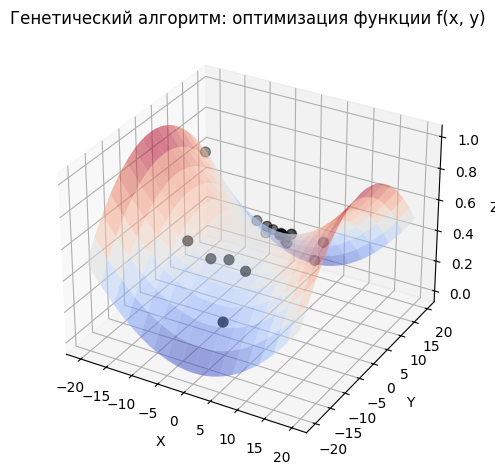

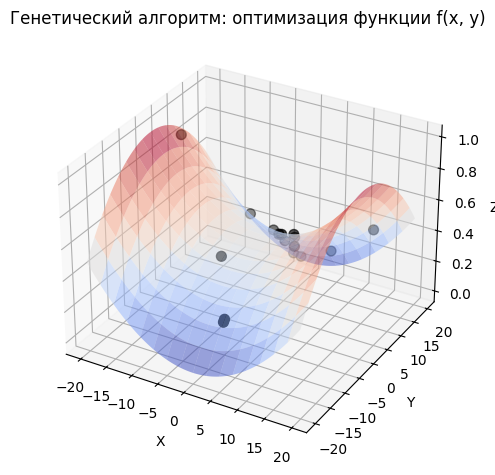

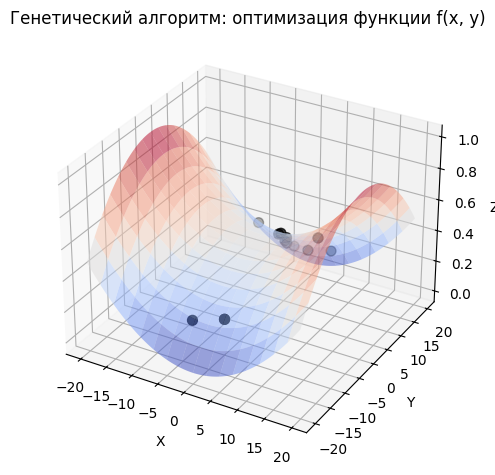

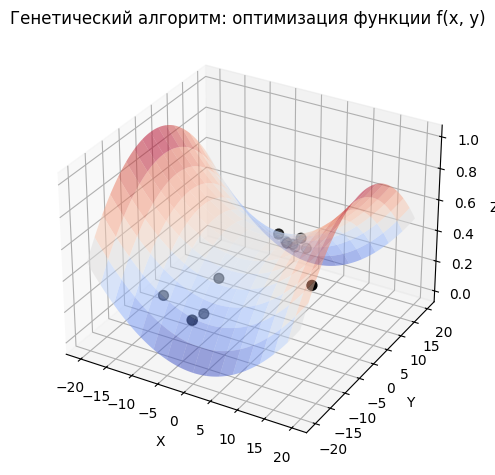

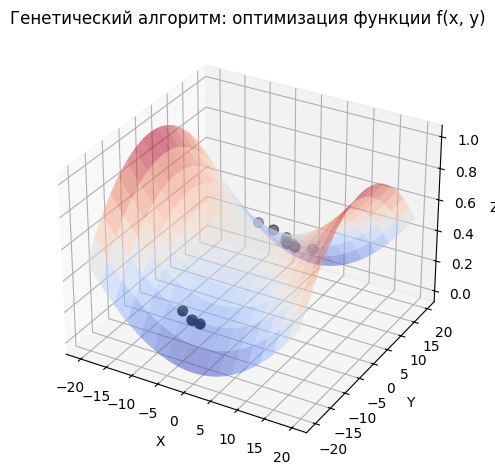

...

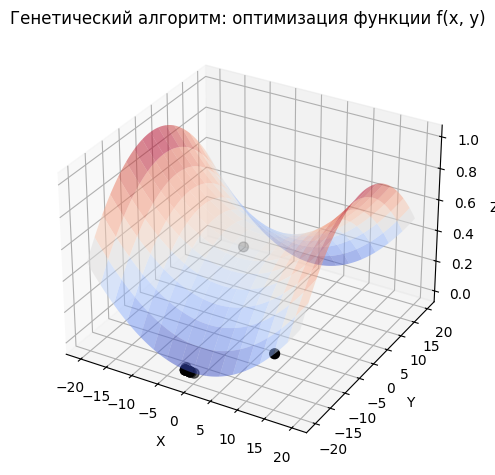

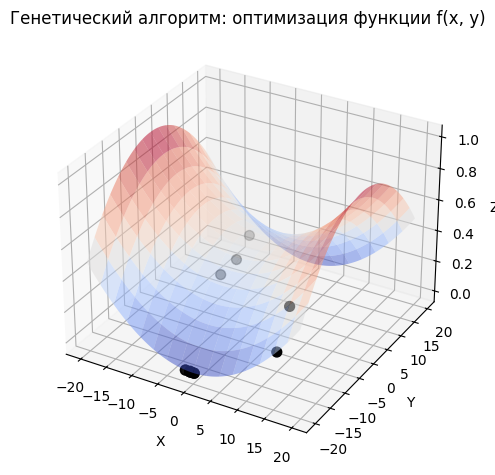

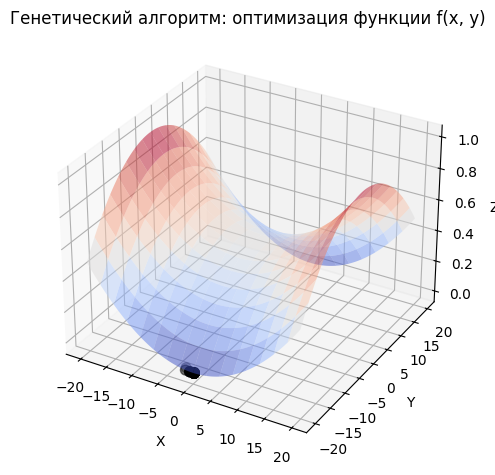

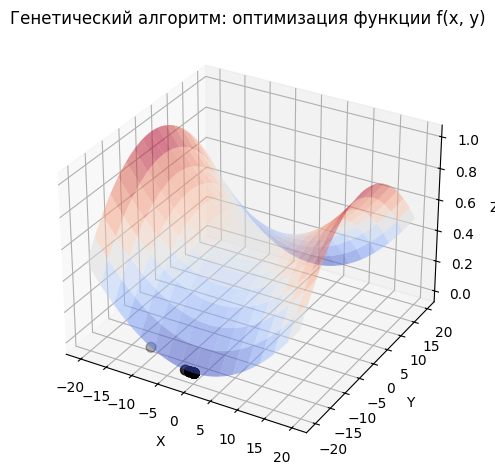

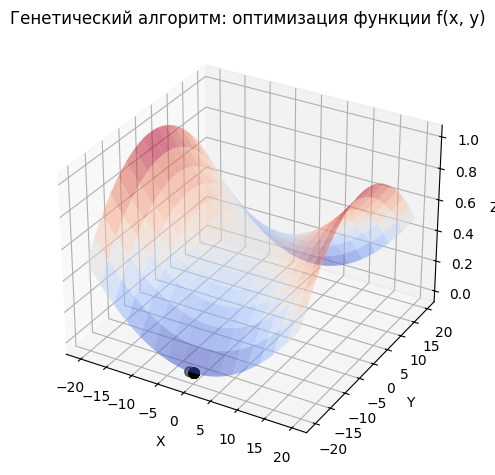

In [ ]:
# Создаем экземпляр класса и запускаем эволюцию
ga = GeneticAlgorithm(f, population_size=20, p = 0.05)
ga.evolve(generations=30, selection_method='tournament')

*Метод сигма-отсечение*

[[14.71231501523463, 17.300143003126777, 0.3964465814735774], [-19.170723009545426, -1.634613425295992, 0.9560558245731957], [8.417615905373683, -4.130433166404233, 0.5672447242353349], [2.2747008868407512, -9.591244938966144, 0.39147785580668804], [-7.925957990801278, -11.43951664850675, 0.41494783615060443], [10.546357499123815, -12.32949194911546, 0.4490116059700277], [-0.941567303059685, 1.7991472160479347, 0.49706202285147255], [-15.121323857338709, 8.781336569576574, 0.6894282040629225], [-4.291089402496237, 17.76082696627413, 0.12870809216785645], [19.75092542475395, -5.515541108479436, 0.9495973267685818], [3.109425716922935, -8.368474741040298, 0.42454644849704026], [13.740513419029725, -13.569857270647908, 0.5058258533409751], [8.363556129539205, -8.098436206936928, 0.5054555026676573], [-4.2683674789930315, 17.233590139837318, 0.15152791478478406], [-1.8672654324136282, 3.268287471321205, 0.4910062214998646], [-17.956695360935893, 6.7609824028065475, 0.845915031542996], [13.

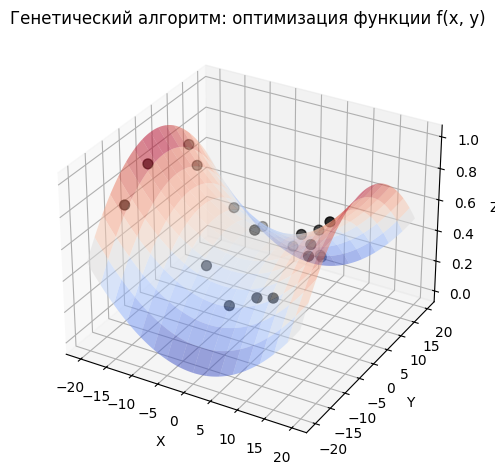

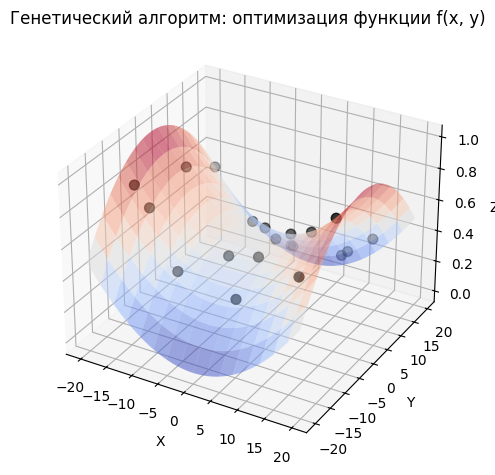

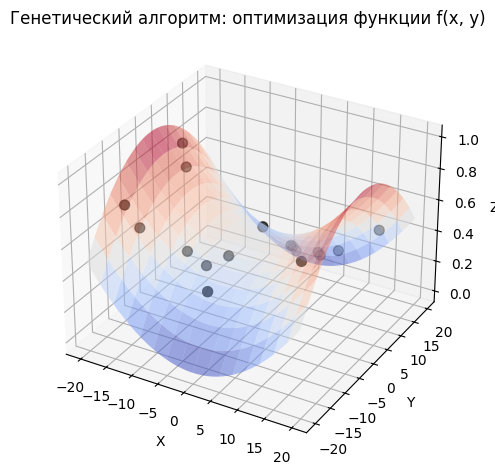

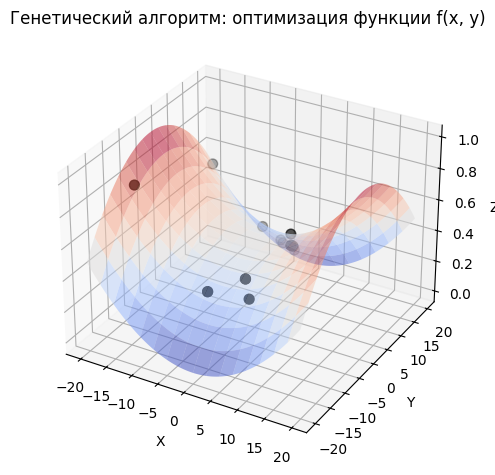

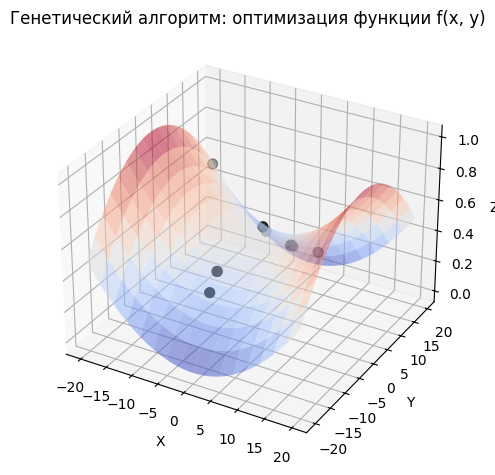

...

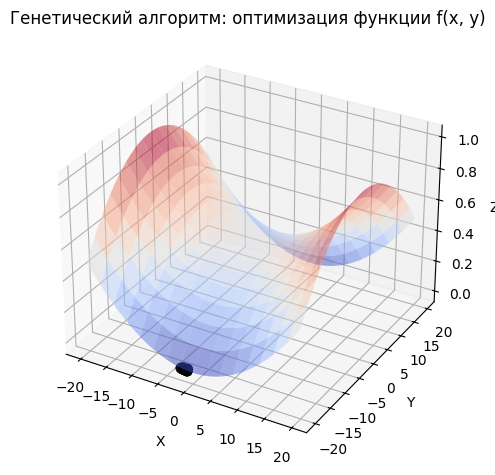

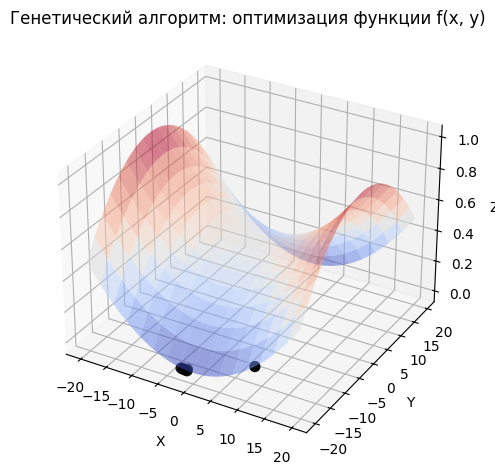

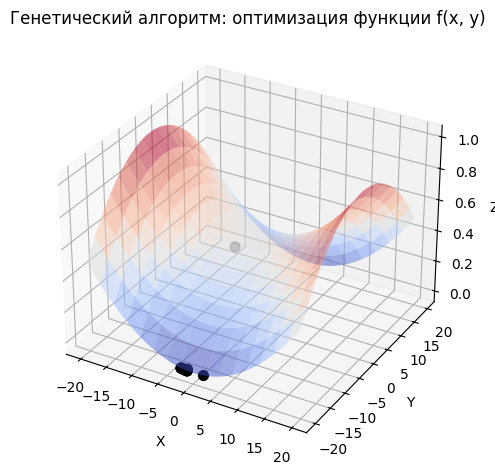

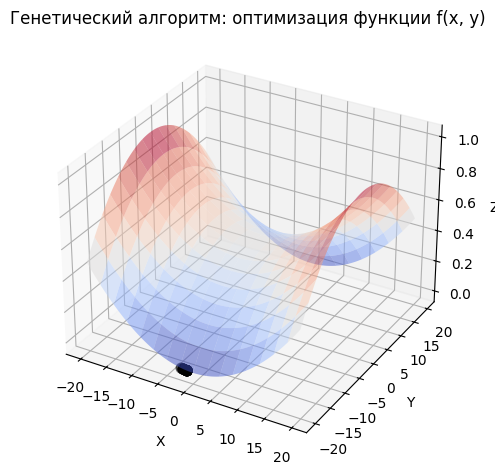

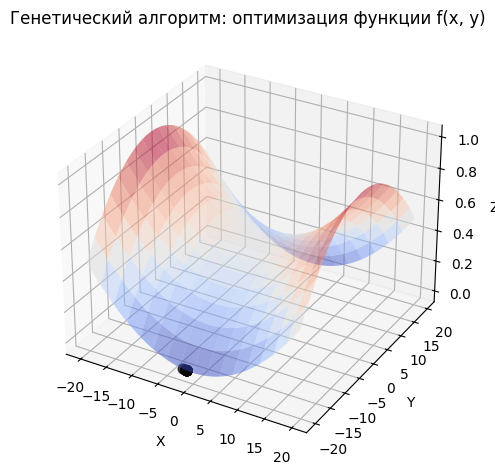

In [ ]:
# Создаем экземпляр класса и запускаем эволюцию
ga = GeneticAlgorithm(f, population_size=20, p = 0.05)
ga.evolve(generations=30, selection_method='sigma')

*Метод равномерного ранжирования*

[[-4.242632990699903, -14.280703543022533, 0.26757680126259864], [-8.766073011794235, -4.182226774591413, 0.5741912690674975], [0.528354956344419, -1.4625680331936373, 0.49767506713521725], [14.955003245879873, 1.6598720089187147, 0.7761211837478571], [3.0688997640545423, 14.733939116637579, 0.2404114798362888], [-16.955567096457433, -16.99229468271943, 0.49844147122261867], [-1.7688435992027038, 13.679497443752112, 0.27000019670602476], [11.597110903454887, -3.9325481277009153, 0.6487850581629353], [1.6822687442784527, 4.605146630745978, 0.47702831579663146], [15.699618418661764, -10.478392830477908, 0.6708516277272161], [13.368450554178708, 18.6281636229128, 0.2896337378218865], [14.383708332711713, 2.73678605237642, 0.7492513343800478], [-17.830826833031033, -3.2806102326027364, 0.8839699775641021], [-1.5661796774306112, 5.167073087818331, 0.46969284310892523], [-13.978909068844176, -16.487626163583084, 0.40446010280618067], [0.4197911028324306, -9.818734082760763, 0.379710856977561

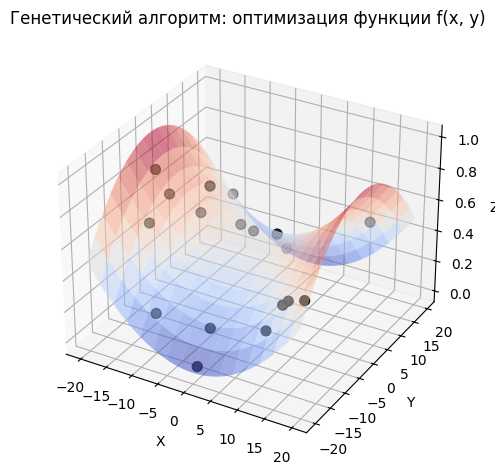

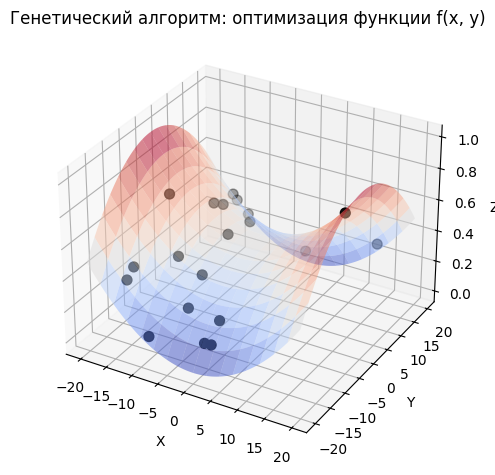

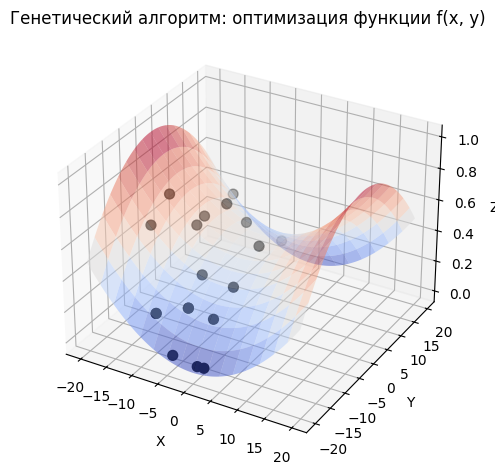

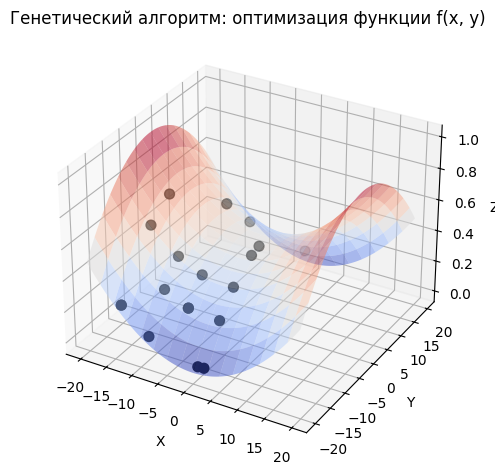

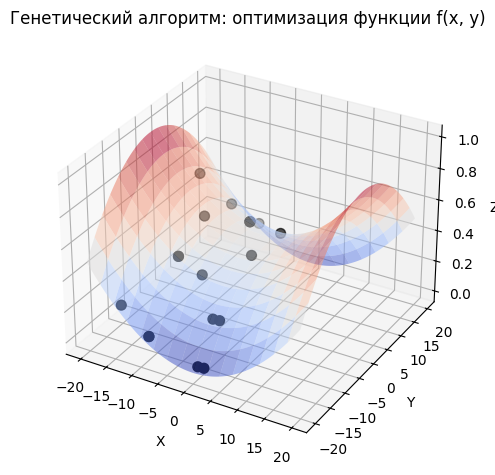

...

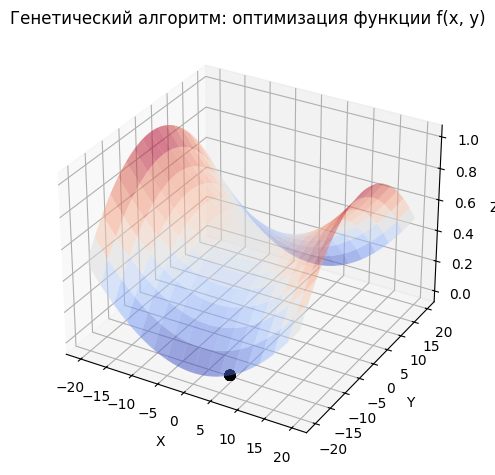

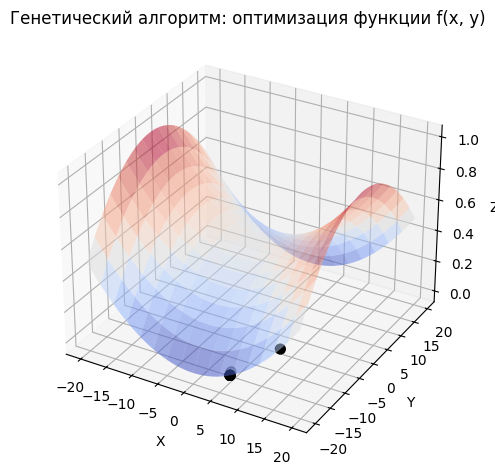

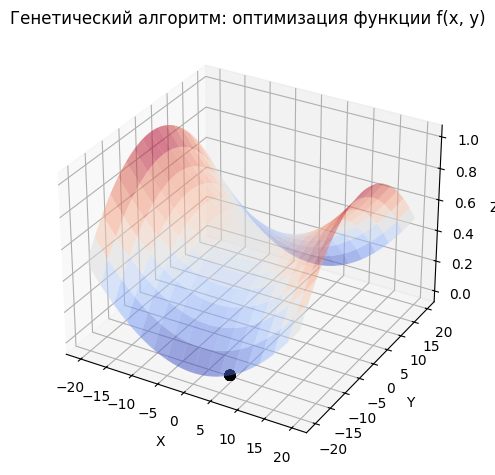

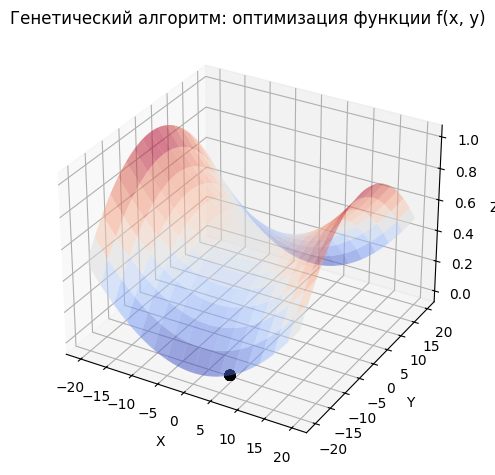

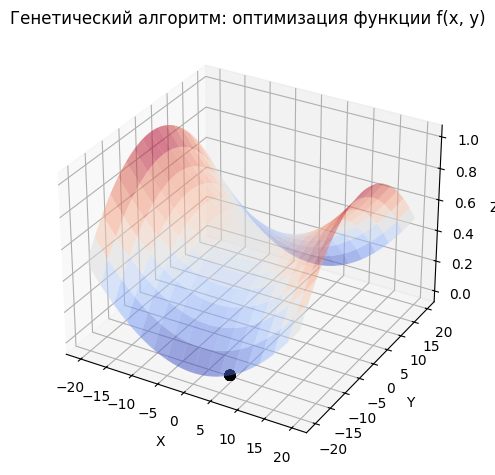

In [ ]:
# Создаем экземпляр класса и запускаем эволюцию
ga = GeneticAlgorithm(f, population_size=20, p = 0.01, parent_selection_method = 'outbreeding')
ga.evolve(generations=100, selection_method='uniform_ranking')